## Project Title: Traffic accidents analysis

### Team Members:

Akshay Dabade

Aniket Nawade

Hrishi Gadkari

### Project Description:

This data set is picked from Kaggle. The traffic data is amassed from the
year 2000 and 2016, recording over 1.6 million accidents in the process and making this one
of the most comprehensive traffic data sets out there. The data consists of various
parameters such as number of casualties, number of vehicles, light/weather/road surface
conditions, longitude and latitude etc.

In [3]:
import numpy as np
ctrl_rate_data = np.genfromtxt('Resources/accidents_2005_to_2007.csv', skip_header=1, delimiter=',')
f99 = ctrl_rate_data[:, 8]

In [4]:
print("The number of casualties reported per accident for the years 2005-2007: ", len(f99) )

print("The total number of casualties for the years 2005-2007: ", np.sum(f99))

The number of casualties reported per accident for the years 2005-2007:  570011
The total number of casualties for the years 2005-2007:  777201.0


In [5]:
ctrl_rate_data1 = np.genfromtxt('Resources/accidents_2009_to_2011.csv', skip_header=1, delimiter=',')
f100 = ctrl_rate_data1[:, 8]

In [6]:
print("The number of casualties reported per accident for the years 2009-2011: ", len(f100) )

print("The total number of casualties for the years 2009-2011: ", np.sum(f100))

The number of casualties reported per accident for the years 2009-2011:  469442
The total number of casualties for the years 2009-2011:  634744.0


In [7]:
ctrl_rate_data2 = np.genfromtxt('Resources/accidents_2012_to_2014.csv', skip_header=1, delimiter=',')
f101 = ctrl_rate_data2[:, 8]

In [8]:
print("The number of accidents recorded for the years 2012-2014: ", len(f101) )

print("The total number of casualties for the years 2012-2014: ", np.sum(f101))

The number of accidents recorded for the years 2012-2014:  464697
The total number of casualties for the years 2012-2014:  620101.0


In [72]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime

import folium
import folium.plugins as fpl

%matplotlib inline
seed =42

In [73]:
accident_07 = pd.read_csv('resources/accidents_2005_to_2007.csv',low_memory=False)
accident_11 = pd.read_csv('resources/accidents_2009_to_2011.csv',low_memory=False)
accident_14 = pd.read_csv('resources/accidents_2012_to_2014.csv',low_memory=False) 
#accident_ = accident_07
accident_ = pd.concat([accident_07,accident_11,accident_14])
print('Number of rows and collumns',accident_07.shape,accident_11.shape,accident_14.shape)

Number of rows and collumns (570011, 33) (469442, 33) (464697, 33)


In [74]:
accident_['Date'] = pd.to_datetime(accident_['Date'],dayfirst=True)
accident_['Month'] = accident_['Date'].dt.month
accident_['Day'] = accident_['Date'].dt.month

In [75]:
def to_hour(time):
    try:
        hour = datetime.strptime(str(time), '%H:%M')
        return int(datetime.strftime(hour, '%H'))
    except Exception:
        return 0

accident_['Time'] = accident_['Time'].apply(to_hour)

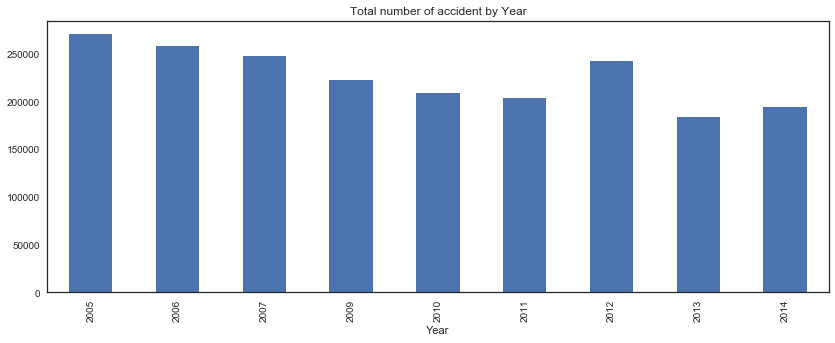

In [76]:
f, ax = plt.subplots(figsize=(14,5))
foo = accident_.groupby('Year').sum()['Number_of_Casualties'].plot(kind='bar', ax =ax)
ax.set_title('Total number of accident by Year');

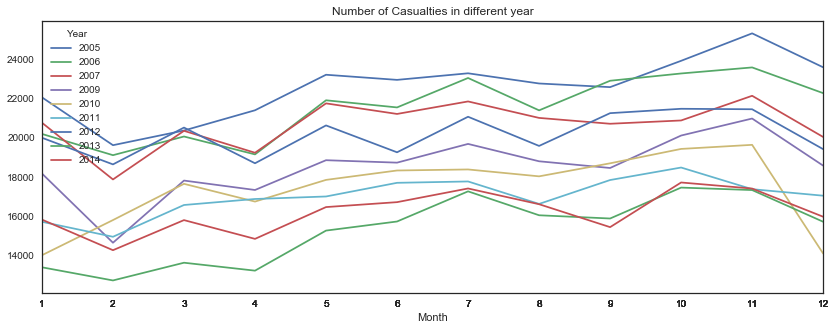

In [77]:
foo = accident_.groupby(['Year','Month']).sum()['Number_of_Casualties'].to_frame().reset_index()

f, ax = plt.subplots(figsize=(14,5))
foo.pivot(columns='Year', values= 'Number_of_Casualties', index = 'Month').plot(ax =ax)
ax.set_title('Number of Casualties in different year')
ax.set_xticks(foo['Month'].values);

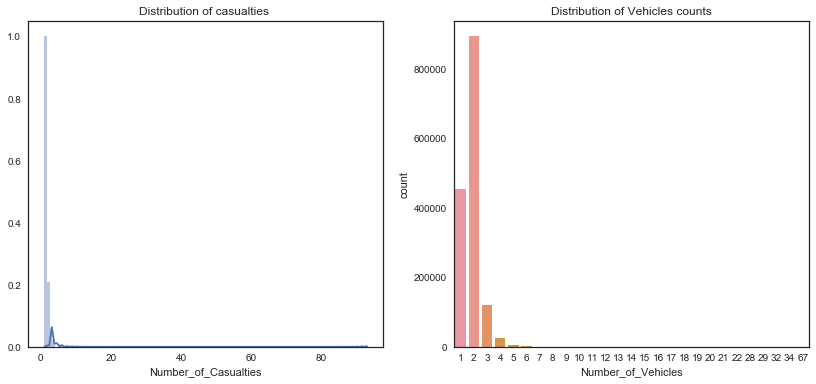

In [78]:
f,ax = plt.subplots(1,2,figsize=(14,6))
sns.distplot(accident_['Number_of_Casualties'],bins=120,ax=ax[0])
ax[0].set_title('Distribution of casualties ')
sns.countplot(accident_['Number_of_Vehicles'],ax=ax[1])
ax[1].set_title('Distribution of Vehicles counts');

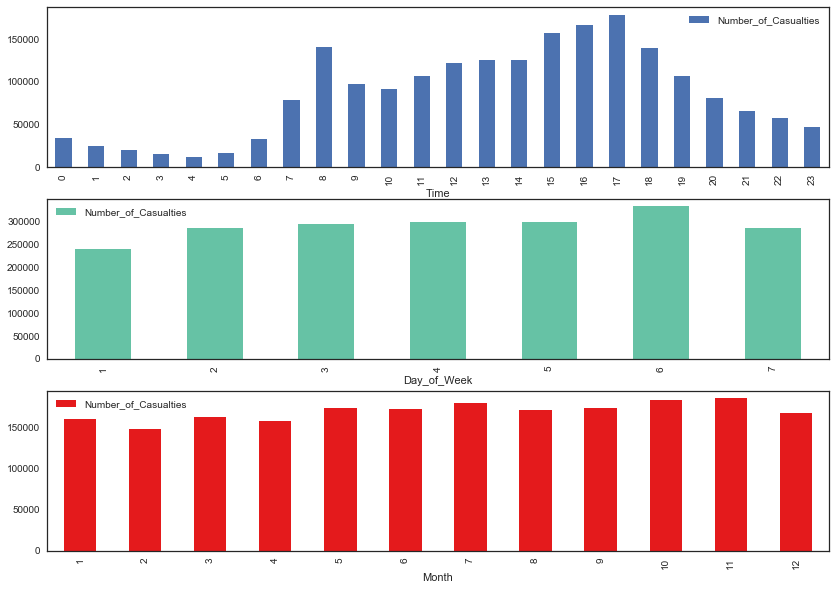

In [79]:
f,ax = plt.subplots(3,1,figsize=(14,10))
#plt.title('Number of Casuaalties in Diffirent Time')

foo = accident_.groupby(['Time']).sum()['Number_of_Casualties'].to_frame().plot(ax=ax[0],kind='bar')

foo = accident_.groupby(['Day_of_Week']).sum()['Number_of_Casualties'].to_frame().plot(ax=ax[1],cmap='Set2',kind='bar')
foo = accident_.groupby(['Month',]).sum()['Number_of_Casualties'].to_frame().plot(ax=ax[2],cmap='Set1',kind='bar')

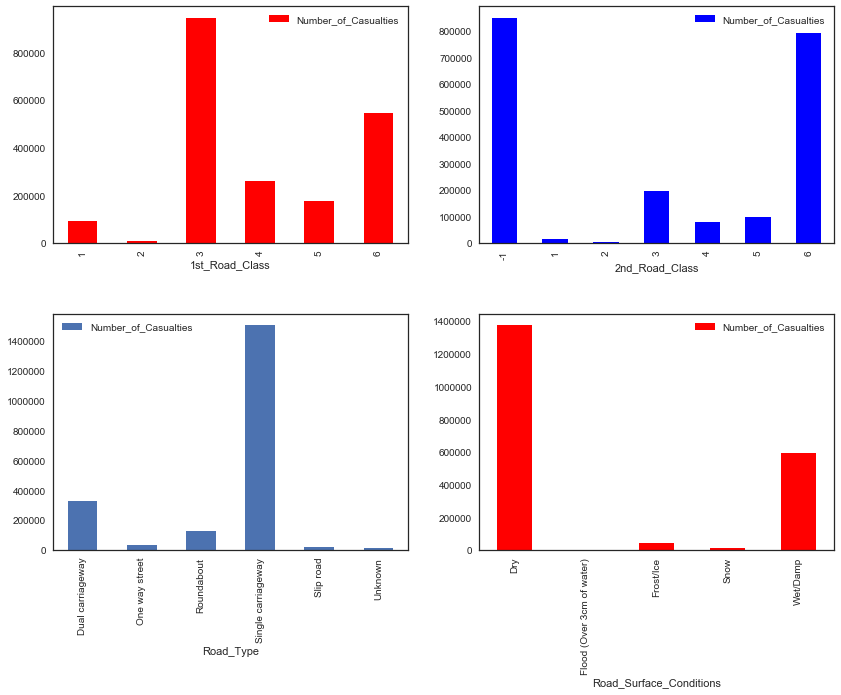

In [80]:
f,ax = plt.subplots(2,2,figsize=(14,10))
foo = accident_.groupby(['1st_Road_Class']).sum()['Number_of_Casualties'].to_frame().plot(kind='bar', ax=ax[0,0],color='r')
foo = accident_.groupby(['2nd_Road_Class']).sum()['Number_of_Casualties'].to_frame().plot(kind='bar', ax=ax[0,1],color='b')

foo = accident_.groupby(['Road_Type']).sum()['Number_of_Casualties'].to_frame().plot(kind='bar', ax=ax[1,0])
foo = accident_.groupby(['Road_Surface_Conditions']).sum()['Number_of_Casualties'].to_frame().plot(kind='bar', ax=ax[1,1],color='r')
plt.subplots_adjust( hspace = 0.3 )

Text(0.5,1,'Police officer Response')

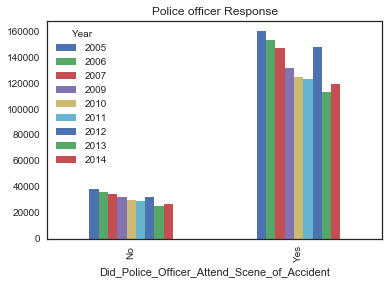

In [81]:
foo = accident_.groupby(['Did_Police_Officer_Attend_Scene_of_Accident','Year']).count()['Number_of_Casualties'].to_frame().reset_index()
foo.pivot(columns='Year', values= 'Number_of_Casualties', index = 'Did_Police_Officer_Attend_Scene_of_Accident').plot(kind='bar')
plt.title('Police officer Response')

In [9]:
#data cleaning
import seaborn as sns
import pandas as pd
data = pd.read_csv('Resources/accidents_2005_to_2007.csv', low_memory=False)


In [10]:
data = data.drop('Junction_Detail', 1)

In [11]:
road_type=np.array(data['Road_Type'])

In [12]:
road_type = set(road_type)
print(road_type)
mapping = {'Dual carriageway': 1, 'One way street': 2, 'Roundabout': 3, 'Single carriageway': 4, 'Slip road': 5, 'Unknown': 6}

data=data.replace({'Road_Type': mapping})


{'One way street', 'Slip road', 'Roundabout', 'Unknown', 'Dual carriageway', 'Single carriageway'}


In [13]:
data.fillna(0, inplace=True)

In [14]:
junction_control=np.array(data['Junction_Control'])
junction_control = set(junction_control)
print(junction_control)

{0, 'Giveway or uncontrolled', 'Automatic traffic signal', 'Authorised person', 'Stop Sign'}


In [15]:
mapping1 = {'Automatic traffic signal': 1, 'Giveway or uncontrolled': 2, 'Authorised person': 3, 'Stop Sign': 4}

data=data.replace({'Junction_Control': mapping1})

In [16]:
pedestrian_crossing_human_control=np.array(data['Pedestrian_Crossing-Human_Control'])
pedestrian_crossing_human_control = set(pedestrian_crossing_human_control)
print(pedestrian_crossing_human_control)

{'Control by other authorised person', 0, 'None within 50 metres', 'Control by school crossing patrol'}


In [17]:
mapping2 = {'Control by school crossing patrol': 1, 'Control by other authorised person': 2, 'None within 50 metres': 3}

data=data.replace({'Pedestrian_Crossing-Human_Control': mapping2})

In [18]:
pedestrian_crossing_physical_facilities=np.array(data['Pedestrian_Crossing-Physical_Facilities'])
pedestrian_crossing_physical_facilities = set(pedestrian_crossing_physical_facilities)
print(pedestrian_crossing_physical_facilities)

{0, 'Pedestrian phase at traffic signal junction', 'Central refuge', 'non-junction pedestrian crossing', 'Zebra crossing', 'Footbridge or subway', 'No physical crossing within 50 meters'}


In [19]:
mapping3 = {'No physical crossing within 50 meters': 1, 'Central refuge': 2, 'Zebra crossing': 3, 'Footbridge or subway': 4, 'non-junction pedestrian crossing': 5, 'Pedestrian phase at traffic signal junction': 6}

data=data.replace({'Pedestrian_Crossing-Physical_Facilities': mapping3})

In [20]:
light_conditions=np.array(data['Light_Conditions'])
light_conditions = set(light_conditions)
print(light_conditions)

{'Darkness: Street lights present but unlit', 'Darkeness: No street lighting', 'Darkness: Street lights present and lit', 'Darkness: Street lighting unknown', 'Daylight: Street light present'}


In [21]:
mapping4 = {'Daylight: Street light present': 1, 'Darkness: Street lighting unknown': 2, 'Darkeness: No street lighting': 3, 'Darkness: Street lights present and lit': 4, 'Darkness: Street lights present but unlit': 5}

data=data.replace({'Light_Conditions': mapping4})

In [22]:
weather_conditions=np.array(data['Weather_Conditions'])
weather_conditions = set(weather_conditions)
print(weather_conditions)

{0, 'Fine with high winds', 'Fog or mist', 'Raining without high winds', 'Unknown', 'Other', 'Raining with high winds', 'Fine without high winds', 'Snowing without high winds', 'Snowing with high winds'}


In [23]:
mapping5 = {'Snowing without high winds': 1, 'Raining without high winds': 2, 'Fine without high winds': 3, 'Fog or mist': 4, 'Raining with high winds': 5, 'Fine with high winds': 6, 'Snowing with high winds': 7, 'Other': 8, 'Unknown':9}

data=data.replace({'Weather_Conditions': mapping5})


In [24]:
road_surface_conditions=np.array(data['Road_Surface_Conditions'])
road_surface_conditions = set(road_surface_conditions)
print(road_surface_conditions)

{0, 'Wet/Damp', 'Frost/Ice', 'Dry', 'Snow', 'Flood (Over 3cm of water)'}


In [25]:
mapping6 = {'Wet/Damp': 1, 'Flood (Over 3cm of water)': 2, 'Dry': 3, 'Snow': 4, 'Frost/Ice': 5}

data=data.replace({'Road_Surface_Conditions': mapping6})

In [26]:
data=data.drop('Special_Conditions_at_Site', 1)
data=data.drop('Carriageway_Hazards', 1)
data=data.drop('Did_Police_Officer_Attend_Scene_of_Accident', 1)
data=data.drop('LSOA_of_Accident_Location', 1)
data=data.drop('Local_Authority_(District)', 1)
data=data.drop('Location_Easting_OSGR', 1)
data=data.drop('Location_Northing_OSGR', 1)

In [29]:
data.corr()

,Longitude,Latitude,Police_Force,Accident_Severity,Number_of_Vehicles,Number_of_Casualties,Day_of_Week,1st_Road_Class,1st_Road_Number,Road_Type,...,Junction_Control,2nd_Road_Class,2nd_Road_Number,Pedestrian_Crossing-Human_Control,Pedestrian_Crossing-Physical_Facilities,Light_Conditions,Weather_Conditions,Road_Surface_Conditions,Urban_or_Rural_Area,Year
Longitude,1.000000,-0.378799,-0.368377,-0.001515,0.025970,-0.034360,-0.004371,-0.055530,-0.078792,-0.009731,...,0.047362,0.030071,0.017780,0.026105,0.045955,0.021086,-0.006493,0.071014,-0.078369,-0.001930
Latitude,-0.378799,1.000000,0.136687,-0.028156,-0.041964,0.030100,0.002965,0.020079,0.036216,0.002674,...,-0.010469,-0.005766,0.000009,-0.031831,0.006558,0.009720,-0.016755,-0.047321,0.014127,0.002860
Police_Force,-0.368377,0.136687,1.000000,-0.021871,-0.024201,0.003357,0.001934,0.035413,-0.004791,-0.005843,...,-0.099266,-0.112062,-0.017549,-0.031681,-0.077739,-0.023567,0.027885,-0.055041,0.232472,0.007567
Accident_Severity,-0.001515,-0.028156,-0.021871,1.000000,0.073370,-0.110936,0.002000,0.021280,0.000060,-0.013443,...,0.071285,0.068744,0.030478,-0.009381,0.013191,-0.055661,0.013345,-0.002434,-0.082840,-0.008257
Number_of_Vehicles,0.025970,-0.041964,-0.024201,0.073370,1.000000,0.222985,-0.003963,-0.142221,-0.007516,-0.097474,...,0.075496,0.067805,0.025885,0.021641,-0.053470,-0.070242,-0.013091,-0.010377,0.042068,-0.002009
Number_of_Casualties,-0.034360,0.030100,0.003357,-0.110936,0.222985,1.000000,-0.004802,-0.084650,0.010787,-0.044828,...,-0.030077,-0.029593,0.000879,0.008896,-0.031188,0.028988,-0.017772,-0.044450,0.120434,-0.001501
Day_of_Week,-0.004371,0.002965,0.001934,0.002000,-0.003963,-0.004802,1.000000,0.009993,0.002174,0.006630,...,0.003030,0.005604,0.001723,0.001844,0.008060,0.011530,0.004949,0.005299,-0.015590,-0.004568
1st_Road_Class,-0.055530,0.020079,0.035413,0.021280,-0.142221,-0.084650,0.009993,1.000000,-0.097588,0.377603,...,0.093173,0.115269,-0.033613,-0.012718,-0.091990,-0.019163,0.023274,0.022625,-0.240545,-0.003975
1st_Road_Number,-0.078792,0.036216,-0.004791,0.000060,-0.007516,0.010787,0.002174,-0.097588,1.000000,0.073159,...,0.030291,0.039308,0.183027,-0.003659,0.035663,0.006971,0.007620,-0.021010,-0.014916,0.003601
Road_Type,-0.009731,0.002674,-0.005843,-0.013443,-0.097474,-0.044828,0.006630,0.377603,0.073159,1.000000,...,0.116385,0.117982,-0.012576,-0.008067,-0.053346,-0.023598,0.017752,0.006993,-0.080666,-0.000381


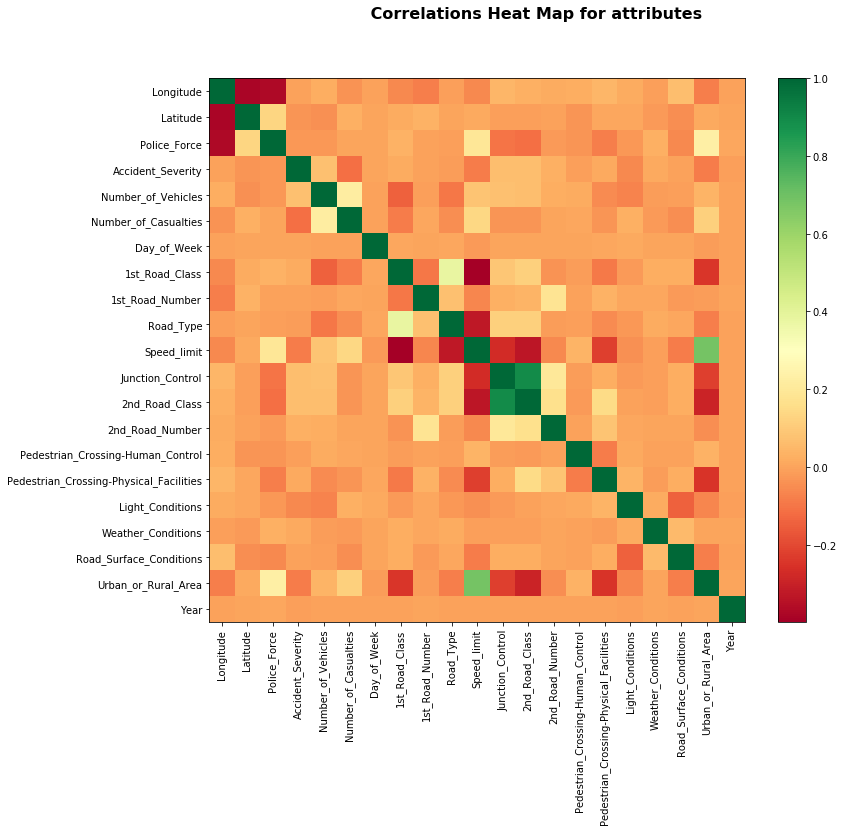

In [28]:
import matplotlib.pyplot as plt
corltn=data.corr()
plt.figure(figsize=(12, 10))
plt.imshow(corltn, cmap='RdYlGn', interpolation='none', aspect='auto')
plt.colorbar()
plt.xticks(range(len(corltn)), corltn.columns, rotation='vertical')
plt.yticks(range(len(corltn)), corltn.columns);
plt.suptitle(' Correlations Heat Map for attributes', fontsize=16, fontweight='bold')
plt.show()

In [39]:
from bokeh.io import output_notebook, show
output_notebook()
from bokeh.plotting import figure, output_file, show, ColumnDataSource
from bokeh.models import HoverTool
import numpy as np
import pandas as pd

Loading BokehJS ...

In [40]:
ds=pd.read_csv("resources/accidents_2005_to_2007.csv")
#total = ds['1stFlrSF'] + ds['2ndFlrSF']
#totalsf=[]
nc=[]
year=[]
longi=[]
lati=[]
nv=[]
tm=[]
ds = ds.fillna('')
    
for ca in ds['Number_of_Casualties']:
    nc.append(ca)

for yr in ds['Year']: 
    year.append(yr)
for ln in ds['Longitude']: 
    longi.append(ln)
for lt in ds['Latitude']:
    lati.append(lt)
for n in ds['Number_of_Vehicles']:
    nv.append(n)
for t in ds['Time']:
    tm.append(t)
    
source2 = ColumnDataSource(data=dict(
    x=year,
    y=nc,
    Longitude=longi,
    Latitude=lati,
    Number_of_Vehicles=nv,
    Time=tm,
))

hover2 = HoverTool(tooltips=[
    ("index", "$index"),
    ("(x,y)", "($x, $y)"),
    ("Longitude", "@Longitude"),
    ("Latitude", "@Latitude"),
    ("Number_of_Vehicles", "@Number_of_Vehicles"),
    ("Time", "@Time"),
    
])


p7 = figure(plot_width=400, plot_height=400, tools=[hover2],
           title="Scatter Plot of accidents from 2005 to 2007")

p7.circle('x', 'y', size=5, source=source2)


show(p7)

C:\Users\aksha\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:2698: DtypeWarning: Columns (31) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


C:\Users\aksha\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:2698: DtypeWarning: Columns (31) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


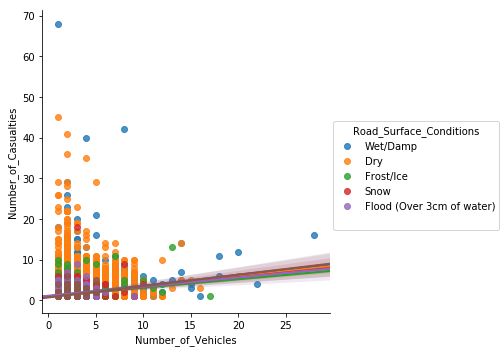

In [33]:
%matplotlib inline
test1 = pd.read_csv('Resources/accidents_2005_to_2007.csv')
test1=test1.fillna('')
sns.lmplot(x="Number_of_Vehicles", y="Number_of_Casualties", hue="Road_Surface_Conditions", data=test1)

In [35]:
import seaborn as sns
import numpy as np
import pandas as pd
from pandas.plotting import scatter_matrix
from sklearn import datasets
import matplotlib.pyplot 
%matplotlib inline

In [36]:
import seaborn as sns
import numpy as np
import pandas as pd
from pandas.plotting import scatter_matrix
from sklearn import datasets
import matplotlib.pyplot 
%matplotlib inline
fields = ['Time', 'Number_of_Casualties','Speed_limit','Weather_Conditions','Year']

df = pd.read_csv('resources/accidents_2005_to_2007.csv', skipinitialspace=True, usecols=fields)
# See the keys
#print df.keys()
# See content in 'star_name'
df[df.Weather_Conditions=='Fine without high winds'][0:7]

,Number_of_Casualties,Time,Speed_limit,Weather_Conditions,Year
1,1,17:36,30,Fine without high winds,2005
2,1,00:15,30,Fine without high winds,2005
3,1,10:35,30,Fine without high winds,2005
4,1,21:13,30,Fine without high winds,2005
6,1,20:40,30,Fine without high winds,2005
7,2,17:35,30,Fine without high winds,2005
8,2,22:43,30,Fine without high winds,2005


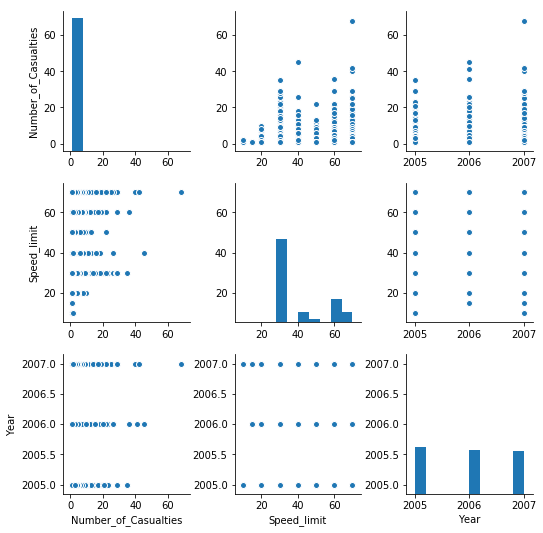

In [45]:
sns.pairplot(df)

In [46]:
import seaborn as sns
import numpy as np
import pandas as pd
from pandas.plotting import scatter_matrix
from sklearn import datasets
import matplotlib.pyplot 
%matplotlib inline
fields = ['Time', 'Number_of_Casualties','Speed_limit','Weather_Conditions','Year']

df1 = pd.read_csv('resources/accidents_2005_to_2007.csv', skipinitialspace=True, usecols=fields)
# See the keys
#print df.keys()
# See content in 'star_name'
df1[df1.Weather_Conditions=='Raining without high winds'][0:20]

,Number_of_Casualties,Time,Speed_limit,Weather_Conditions,Year
0,1,17:42,30,Raining without high winds,2005
5,1,12:40,30,Raining without high winds,2005
12,1,12:55,30,Raining without high winds,2005
13,1,05:01,30,Raining without high winds,2005
25,1,16:35,30,Raining without high winds,2005
27,2,13:15,30,Raining without high winds,2005
28,1,18:20,30,Raining without high winds,2005
30,2,17:30,30,Raining without high winds,2005
33,2,13:00,30,Raining without high winds,2005
46,1,18:10,30,Raining without high winds,2005


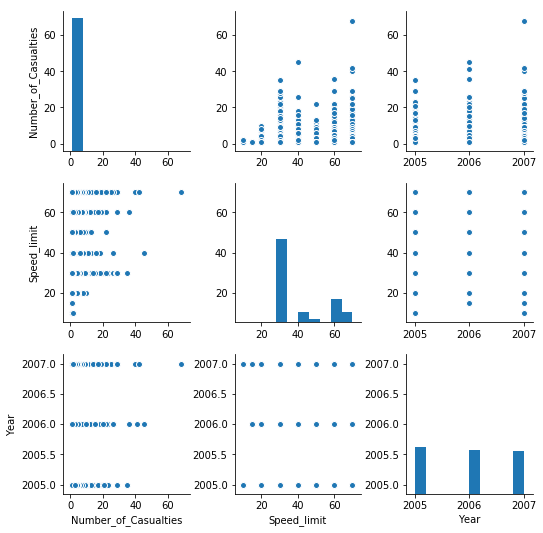

In [47]:
sns.pairplot(df1)

In [54]:
import numpy as np # linear algebra
import pandas as pd
import os

df = pd.read_csv('resources/accidents_2005_to_2007.csv', skipinitialspace=True, usecols=fields,encoding='utf-8')
frame_list = []
for x in df:
    df = pd.read_csv('resources/accidents_2005_to_2007.csv', parse_dates=[9,11])
    frame_list.append(df)
accident_data = pd.concat(frame_list)
print(accident_data.size)

C:\Users\aksha\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:2698: DtypeWarning: Columns (31) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


94051815


In [55]:
accident_loc_data = accident_data[accident_data['Speed_limit']==30] # Reducing data size so it runs faster
accident_loc_data = accident_loc_data[accident_loc_data['Year']==2007] # Reducing data size so it runs faster
accident_loc_data = accident_loc_data[accident_loc_data['Number_of_Vehicles']==4] # Reducing data size so it runs faster
accident_loc_data = accident_loc_data[['Latitude', 'Longitude']]
accident_loc_data = accident_loc_data.dropna(axis=0, subset=['Latitude','Longitude'])
accident_loc_data.describe()

,Latitude,Longitude
count,6860.000000,6860.000000
mean,52.505067,-1.501164
std,1.340288,1.379116
min,50.154073,-5.075050
25%,51.488354,-2.446798
50%,52.157775,-1.549173
75%,53.454239,-0.254223
max,58.592039,1.725861


Text(0,0.5,'No of Accidents')

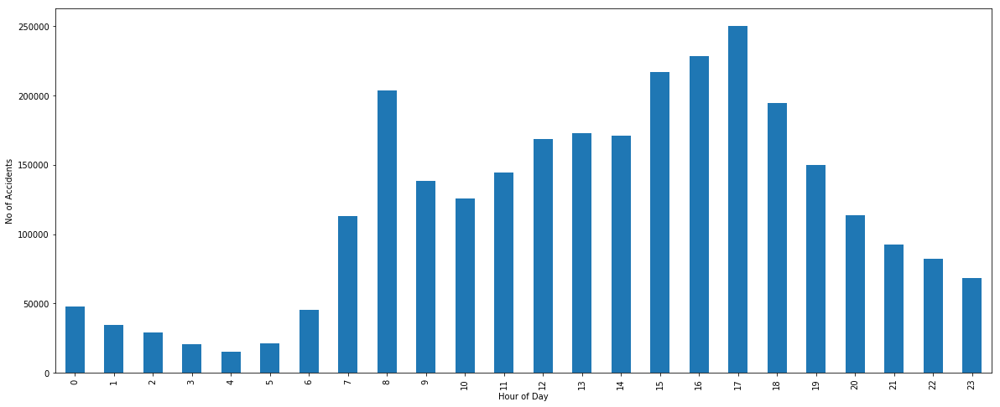

In [56]:
accidents_by_time = accident_data.Time.value_counts()
accidents_by_hour = accidents_by_time.groupby(accidents_by_time.index.hour).sum()
plot = accidents_by_hour.plot('bar', figsize=(20,8))
plot.set_xlabel("Hour of Day")
plot.set_ylabel("No of Accidents")

Text(0,0.5,'No of Accidents')

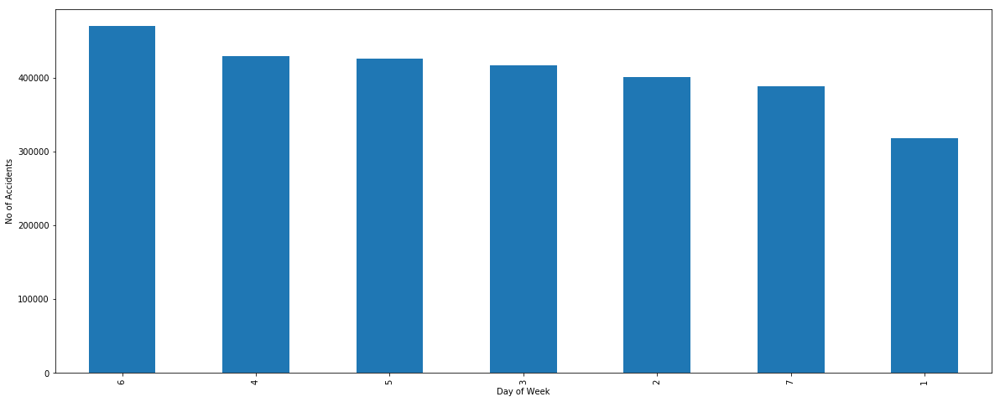

In [57]:
accidents_by_dow = accident_data.Day_of_Week.value_counts()
plot = accidents_by_dow.plot('bar', figsize=(20,8))
plot.set_xlabel("Day of Week")
plot.set_ylabel("No of Accidents")

C:\Users\aksha\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:2698: DtypeWarning: Columns (31) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


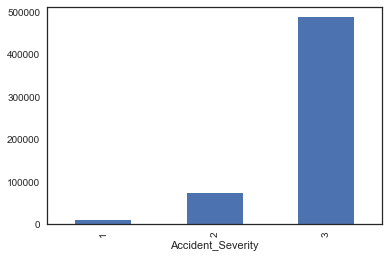

In [83]:
df= pd.read_csv('Resources/accidents_2005_to_2007.csv', skipinitialspace=True)

df_count = df.groupby(df.Accident_Severity).Accident_Severity.count().plot(kind = 'bar')


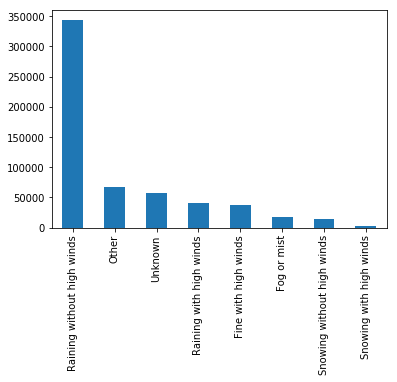

In [26]:
pd.value_counts(accident_data['Weather_Conditions']).drop('Fine without high winds').plot.bar()

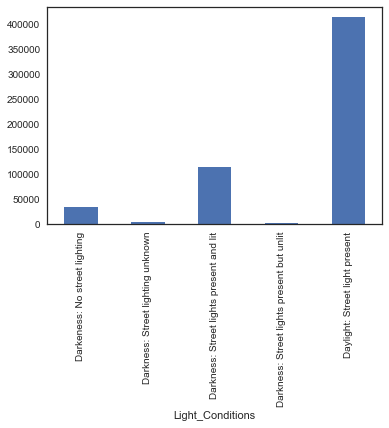

In [61]:
df_count = df.groupby(df.Light_Conditions).Accident_Severity.count().plot(kind = 'bar')

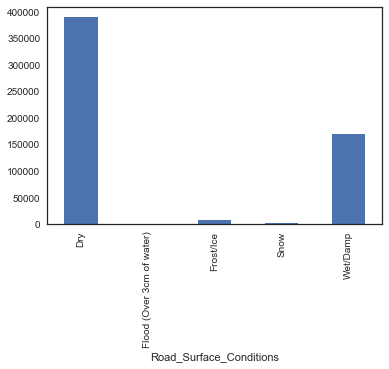

In [62]:
df_count = df.groupby(df.Road_Surface_Conditions).Accident_Severity.count().plot(kind = 'bar')

C:\Users\aksha\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:57: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  return getattr(obj, method)(*args, **kwds)


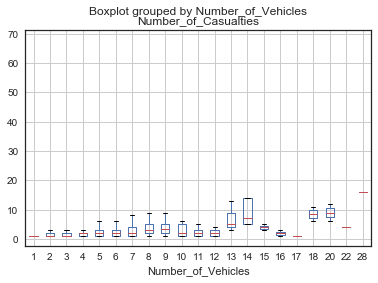

In [84]:
df.boxplot(column="Number_of_Casualties", by="Number_of_Vehicles")

In [60]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline 
import seaborn as sns
sns.set(style="white")

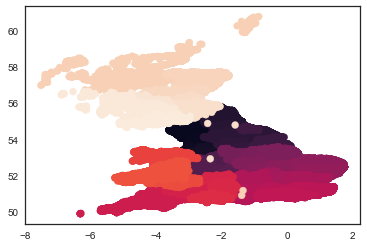

In [29]:
plt.scatter(df.Longitude,df.Latitude,c = df.Police_Force)

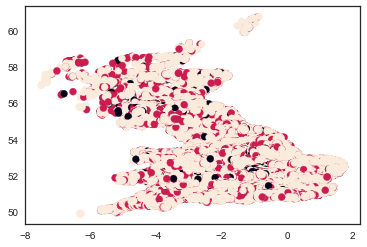

In [30]:
plt.scatter(df.Longitude,df.Latitude,c = df.Accident_Severity)

In [63]:
corrmat = df.corr()

In [65]:
import seaborn as sns
import numpy as np
import pandas as pd
from pandas.plotting import scatter_matrix
from sklearn import datasets
import matplotlib.pyplot 
%matplotlib inline

In [66]:
ds=pd.read_csv("resources/accidents_2005_to_2007.csv")
ds.head()

C:\Users\aksha\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:2698: DtypeWarning: Columns (31) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,Accident_Index,Location_Easting_OSGR,Location_Northing_OSGR,Longitude,Latitude,Police_Force,Accident_Severity,Number_of_Vehicles,Number_of_Casualties,Date,...,Pedestrian_Crossing-Physical_Facilities,Light_Conditions,Weather_Conditions,Road_Surface_Conditions,Special_Conditions_at_Site,Carriageway_Hazards,Urban_or_Rural_Area,Did_Police_Officer_Attend_Scene_of_Accident,LSOA_of_Accident_Location,Year
0,200501BS00001,525680.0,178240.0,-0.191170,51.489096,1,2,1,1,04/01/2005,...,Zebra crossing,Daylight: Street light present,Raining without high winds,Wet/Damp,None,None,1,Yes,E01002849,2005
1,200501BS00002,524170.0,181650.0,-0.211708,51.520075,1,3,1,1,05/01/2005,...,Pedestrian phase at traffic signal junction,Darkness: Street lights present and lit,Fine without high winds,Dry,None,None,1,Yes,E01002909,2005
2,200501BS00003,524520.0,182240.0,-0.206458,51.525301,1,3,2,1,06/01/2005,...,No physical crossing within 50 meters,Darkness: Street lights present and lit,Fine without high winds,Dry,None,None,1,Yes,E01002857,2005
3,200501BS00004,526900.0,177530.0,-0.173862,51.482442,1,3,1,1,07/01/2005,...,No physical crossing within 50 meters,Daylight: Street light present,Fine without high winds,Dry,None,None,1,Yes,E01002840,2005
4,200501BS00005,528060.0,179040.0,-0.156618,51.495752,1,3,1,1,10/01/2005,...,No physical crossing within 50 meters,Darkness: Street lighting unknown,Fine without high winds,Wet/Damp,None,None,1,Yes,E01002863,2005


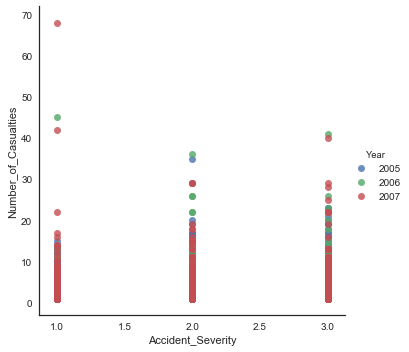

In [67]:
sns.lmplot("Accident_Severity", "Number_of_Casualties", data=ds, hue="Year", fit_reg=False)

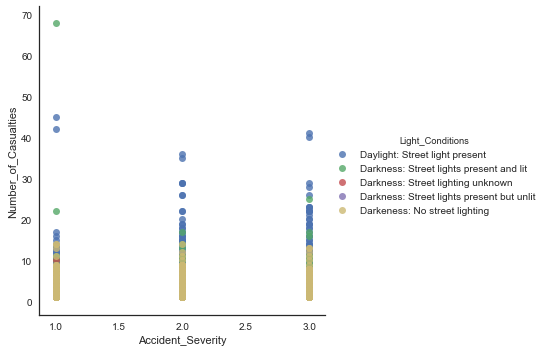

In [68]:
sns.lmplot(x="Accident_Severity", y="Number_of_Casualties", hue="Light_Conditions", data=test1, fit_reg=False)

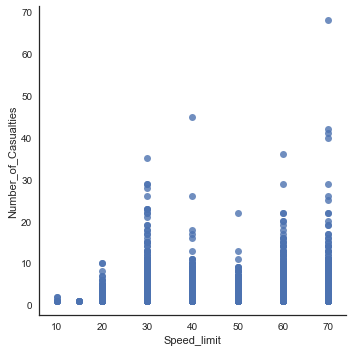

In [70]:
sns.lmplot(x="Speed_limit", y="Number_of_Casualties", data=data, fit_reg=False)

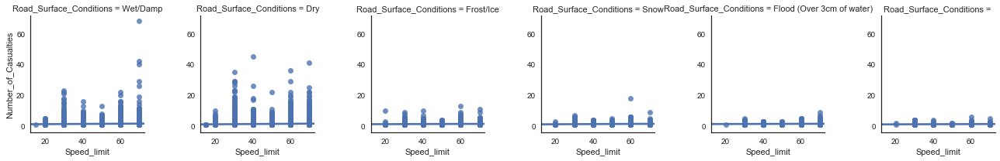

In [71]:
g = sns.FacetGrid(test1, col="Road_Surface_Conditions")
g.map(sns.regplot, "Speed_limit", "Number_of_Casualties")

In [86]:
from sklearn import linear_model
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
import warnings
warnings.filterwarnings('ignore')
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score

In [90]:
lin_cas=data["Number_of_Casualties"]
lin_v=data["Number_of_Vehicles"]
print(lin_cas.shape,lin_v.shape)

(570011,) (570011,)


In [91]:
X_train, X_test, Y_train, Y_test = train_test_split(lin_v, lin_cas, test_size=0.2, random_state=42)
X_trainsales = X_train[:, np.newaxis]# another way to convert vector to matrix
X_testsales = X_test[:, np.newaxis]
Y_trainsales = Y_train[:, np.newaxis]
Y_testsales = Y_test[:, np.newaxis]

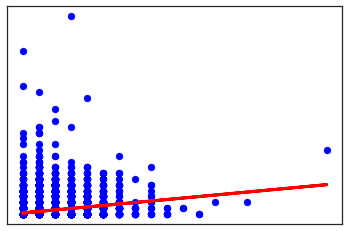

Coefficeints, the fitted model  [[ 0.25648829]]


In [92]:
regr = linear_model.LinearRegression()
regr.fit(X_trainsales, Y_trainsales)
y_pred = regr.predict(X_testsales)
plt.scatter(X_testsales, Y_testsales,  color='blue')
plt.plot(X_testsales, y_pred, color='red', linewidth=3)
plt.xticks(())
plt.yticks(())
plt.show()
print("Coefficeints, the fitted model ",regr.coef_)

### Machine Learning

#### Classification

As show from the dataset utilized, it can be seen the data is categorized rather than quantified, and therefore, we selected the Decision-Tree model for classification. The taget in our dataset is the Accidet_Severity which could be: Fatal, Serious or Slight.

In [93]:
import matplotlib.patches as mpatches
from sklearn.tree import DecisionTreeClassifier
y = data.Accident_Severity

In [94]:
X = data[[
       'Road_Type', 'Speed_limit',
       'Junction_Control', 'Light_Conditions',
       'Weather_Conditions', 'Road_Surface_Conditions']]

In [95]:
X_train, X_test, y_train, y_test = train_test_split(X,y)
print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)

(427508, 6) (142503, 6) (427508,) (142503,)


In [96]:
clf_1 = DecisionTreeClassifier().fit(X_train, y_train)
clf_2 = DecisionTreeClassifier().fit(X_test, y_test)
z1 = clf_1.predict(X_train)
z2 = clf_2.predict(X_test)
print(len(X_train), len(y_train), len(z1))
print(len(X_test), len(y_test), len(z2))

427508 427508 427508
142503 142503 142503


In [97]:
X_train['target_actual'] = y_train
X_train['target_expected'] = z1
X_train.head()

,Road_Type,Speed_limit,Junction_Control,Light_Conditions,Weather_Conditions,Road_Surface_Conditions,target_actual,target_expected
186971,1,30,1,4,3,3,2,3
220897,1,70,0,1,3,3,3,3
156736,4,30,0,1,3,3,3,3
316702,4,60,2,1,3,3,2,3
234841,4,30,2,1,2,1,3,3


In [98]:
X_test['target_actual'] = y_test
X_test['target_expected'] = z2
X_test.head()

,Road_Type,Speed_limit,Junction_Control,Light_Conditions,Weather_Conditions,Road_Surface_Conditions,target_actual,target_expected
375716,1,30,1,1,3,3,3,3
71214,4,30,0,1,3,3,3,3
533532,4,60,0,1,3,3,2,3
194717,1,30,2,4,3,3,3,3
217653,1,30,2,4,3,3,3,3


In [99]:
print(len(X_test))
X_test['result'] = np.where(X_test['target_actual'] == X_test['target_expected'] 
                     , 1, 0)
X_test.head()

142503


,Road_Type,Speed_limit,Junction_Control,Light_Conditions,Weather_Conditions,Road_Surface_Conditions,target_actual,target_expected,result
375716,1,30,1,1,3,3,3,3,1
71214,4,30,0,1,3,3,3,3,1
533532,4,60,0,1,3,3,2,3,0
194717,1,30,2,4,3,3,3,3,1
217653,1,30,2,4,3,3,3,3,1


### Prediction Error percentage between actual and predicted

In [100]:
X_test.result.astype(int)
count_false=len(X_test[(X_test['result']==0)])
count_true=len(X_test[(X_test['result']==1)])
Size=len(X_test)
PerPreErr=(count_false/Size)*100
print('false=',count_false,'\ntrue=',count_true,'\nSize=',Size)
print('Prediction Error=',format(round(PerPreErr,2)),'%')


false= 20571 
true= 121932 
Size= 142503
Prediction Error= 14.44 %


#### Trying to balance between the train and test datasets

In [101]:
size=0.4
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=size)
print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)

clf_1 = DecisionTreeClassifier().fit(X_train, y_train)
clf_2 = DecisionTreeClassifier().fit(X_test, y_test)
z1 = clf_1.predict(X_train)
z2 = clf_2.predict(X_test)


X_train['target_actual'] = y_train
X_train['target_expected'] = z1
X_train.head()

X_test['target_actual'] = y_test
X_test['target_expected'] = z2



X_test['result'] = np.where(X_test['target_actual'] == X_test['target_expected'] 
                     , 1, 0)


X_test.result.astype(int)
count_false=len(X_test[(X_test['result']==0)])
count_true=len(X_test[(X_test['result']==1)])
Size=len(X_test)
PerPreErr=(count_false/Size)*100
print('false=',count_false,'\ntrue=',count_true,'\nSize=',Size)
print('Prediction Error=',format(round(PerPreErr,2)),'%')

(342006, 6) (228005, 6) (342006,) (228005,)
false= 32851 
true= 195154 
Size= 228005
Prediction Error= 14.41 %


## Linear Regression Model

In the previous section, the classification has been performed using the Decision-Tree model based on the assumption that our data is categorized rather than quantified, however, we have created a new dataset that aggregates; counting the number of accidents, our data according to different attribute, where our target (class) is the number of fatal accidents. This section will test using the Linear regression classification model as it will be shown.

In [102]:
from sklearn.linear_model import LinearRegression
# Create a LinearRegression Object
lreg = LinearRegression()

In [103]:
# Working on the most expectedly affecting features
df_Accidents_Fatal=data[(data.Accident_Severity==1)]
df_Accidents_Fatal=df_Accidents_Fatal[[
       'Road_Type', 'Speed_limit',
       'Junction_Control', 'Light_Conditions',
       'Weather_Conditions', 'Road_Surface_Conditions']]


df_Accidents_Fatal.head()

,Road_Type,Speed_limit,Junction_Control,Light_Conditions,Weather_Conditions,Road_Surface_Conditions
824,2,30,2,1,3,3
16252,4,30,1,1,3,3
17413,4,30,1,1,3,1
17415,4,30,2,1,3,3
17420,4,30,2,1,3,3


Aggregating our data grouped by the chosen features and create a new dataframe. Notice that target refers to the number (count) of accidents according to the group by function

In [104]:
def highlight_t(s):
    return ['background-color: orange' for v in s]

df_Fatal_ML=pd.DataFrame(df_Accidents_Fatal.groupby(['Road_Type', 'Speed_limit','Junction_Control', 'Light_Conditions','Weather_Conditions', 'Road_Surface_Conditions']).size().reset_index(name = "Target"))
df_Fatal_ML.head().style.apply(highlight_t,subset=['Target'])

,Road_Type,Speed_limit,Junction_Control,Light_Conditions,Weather_Conditions,Road_Surface_Conditions,Target
0,1,20,0,4,3,3,1
1,1,30,0,1,2,1,3
2,1,30,0,1,3,1,5
3,1,30,0,1,3,3,44
4,1,30,0,1,6,3,1


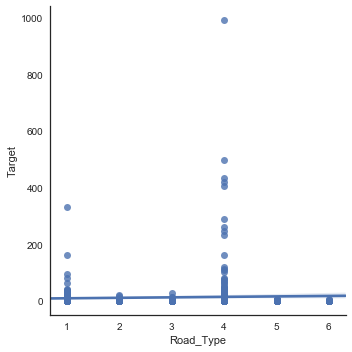

In [105]:
sns.lmplot('Road_Type','Target',data = df_Fatal_ML)

Despite the reported statistical significance of the determined β values, it does not appear that a linear decision boundary exists to separate the two classes. This is not surprising, given that the majority of the predictors are qualitative and the few that are quantitative do not have much variation. Intuitively, I would not expect a linear decision boundary capable of linearly separating so many categorical predictors

In [106]:
# Data Columns
X_multi = df_Fatal_ML.drop('Target',1)

# Targets
Y_target = df_Fatal_ML.Target

# Implement Linear Regression
lreg.fit(X_multi,Y_target)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False)

In [107]:
print(' The estimated intercept coefficient is %.2f ' %lreg.intercept_)

print(' The number of coefficients used was %d ' % len(lreg.coef_))

 The estimated intercept coefficient is 25.30 
 The number of coefficients used was 6 


In [108]:
def highlight_max(s):
    is_max = s == s.max()
    return ['background-color: orange' if v else '' for v in is_max]


# Set a DataFrame from the Features
coeff_df = pd.DataFrame(df_Fatal_ML.columns)
coeff_df.columns = ['Features']

# Set a new column lining up the coefficients from the linear regression
coeff_df["Coefficient Estimate"] = pd.Series(lreg.coef_)
# Show
coeff_df.style.apply(highlight_max,subset=['Coefficient Estimate'])

,Features,Coefficient Estimate
0,Road_Type,1.83112
1,Speed_limit,0.100622
2,Junction_Control,-4.16962
3,Light_Conditions,-3.80914
4,Weather_Conditions,-3.24688
5,Road_Surface_Conditions,2.41126
6,Target,nan


### Training and Validation

In [109]:
# Grab the output and set as X and Y test and train data sets!
#X_train, X_test, Y_train, Y_test = sklearn.cross_validation.train_test_split(X,df_Fatal_ML.Target)

from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(X_multi,df_Fatal_ML.Target)
print(X_train.shape, X_test.shape, Y_train.shape, Y_test.shape)

(483, 6) (162, 6) (483,) (162,)


In [110]:
lreg = LinearRegression()

# Once again do a linear regression, except only on the training sets this time
lreg.fit(X_train,Y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False)

In [111]:
# Predictions on training and testing sets
pred_train = lreg.predict(X_train)
pred_test = lreg.predict(X_test)

In [112]:
print("Fit a model X_train, and calculate MSE with Y_train: %.2f"  % np.mean((Y_train - pred_train) ** 2))
    
print("Fit a model X_train, and calculate MSE with X_test and Y_test: %.2f"  %np.mean((Y_test - pred_test) ** 2))

Fit a model X_train, and calculate MSE with Y_train: 3089.97
Fit a model X_train, and calculate MSE with X_test and Y_test: 4148.87


### Residual Plots

Text(0.5,1,'Residual Plots')

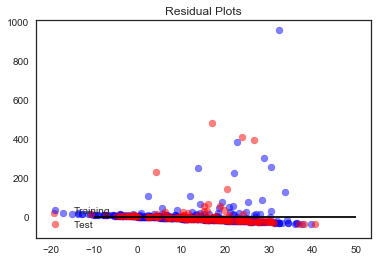

In [113]:
# Scatter plot the training data
train = plt.scatter(pred_train,(Y_train-pred_train),c='b',alpha=0.5)

# Scatter plot the testing data
test = plt.scatter(pred_test,(Y_test-pred_test),c='r',alpha=0.5)

# Plot a horizontal axis line at 0
plt.hlines(y=0,xmin=-10,xmax=50)

#Labels
plt.legend((train,test),('Training','Test'),loc='lower left')
plt.title('Residual Plots')

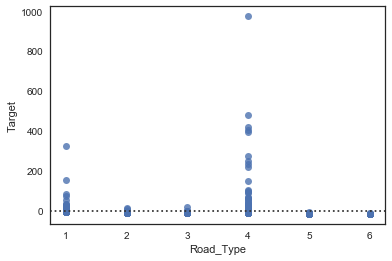

In [114]:
# Residual plot of all the dataset using seaborn
sns.residplot('Road_Type', 'Target', data = df_Fatal_ML)

### Logistic Regression

In [123]:
from sklearn import linear_model, neighbors

In [118]:
X_log = data.Accident_Severity
Y_log = data[['Urban_or_Rural_Area', 'Speed_limit']]

In [119]:
X_train, X_test, Y_train, Y_test = train_test_split(Y_log, X_log, test_size=0.2, random_state=42)
X_trainsales = X_train
X_testsales = X_test
Y_trainsales = Y_train[:, np.newaxis]
Y_testsales = Y_test[:, np.newaxis]

In [120]:
logistic = linear_model.LogisticRegression()
mdl = logistic.fit(X_trainsales, Y_trainsales)

In [121]:
print('LogisticRegression score: %f'
      % logistic.fit(X_trainsales, Y_trainsales).score(X_testsales, Y_testsales))

LogisticRegression score: 0.855749


In [124]:
knn = neighbors.KNeighborsClassifier()
print('KNN score: %f' % knn.fit(X_trainsales, Y_trainsales).score(X_testsales, Y_testsales))

KNN score: 0.855749


## K-NN

In [125]:
X_new = data[['Speed_limit', 'Urban_or_Rural_Area']]

In [126]:
Y_new = data.Year

In [ ]:
X_train, X_test, Y_train, Y_test = train_test_split(X_new, Y_new, test_size=0.2, random_state=42)
X_trainsales = X_train
X_testsales = X_test
Y_trainsales = Y_train[:, np.newaxis]
Y_testsales = Y_test[:, np.newaxis]

In [ ]:
accuracy_array_data = []
karray_data = []
for k in range(3,10,2):
    knn = KNeighborsClassifier(n_neighbors=k)
    accuracy = cross_val_score(knn, X_trainsales, Y_train, cv=10, scoring='accuracy')
    accuracy_array_data.append(accuracy.mean())
    karray_data.append(k)

In [ ]:
class_error = 1.0 - np.array(accuracy_array_data)
plt.plot(karray_data, class_error)
plt.xlabel('K')
plt.ylabel('Classification Error')
plt.show()
minimumind = np.argmin(class_error)
OptimumK = karray_data[minimumind]
print ("Optimal K is %d " %  OptimumK)

In [ ]:
# Use Optimal value of K for test set
knn = KNeighborsClassifier(n_neighbors=OptimumK)

# fitting the model
knn.fit(X_trainsales, Y_train)

# predict
pred = knn.predict(X_testsales)

# evaluate accuracy
print(accuracy_score(Y_test, pred))

In [ ]:
plt.plot(karray_data)
plt.ylabel('mean_squared_error_value')
plt.show()

In [ ]:
plt.plot(class_error)
plt.ylabel('mean_squared_error_value')
plt.show()

In [85]:
import folium
from sklearn.cluster import KMeans

acc_locations = accident_data.dropna(axis=0, subset=['Latitude','Longitude'])
kmeans = KMeans(n_clusters=20, random_state=0).fit(acc_locations[['Latitude', 'Longitude']])

centers = kmeans.cluster_centers_
#print(centers)
map = folium.Map(location=[53.5074, -0.1278], zoom_start=6)
for point in range(0, len(centers)):
    folium.Marker(centers[point]).add_to(map)
map